Aggregate data

In [3]:
from everything import *
%matplotlib inline
aggregate_number = 100
agg_type = "std"
aggdf = pd.concat(
    (chunk.groupby(chunk.index//aggregate_number).agg("acoustic_data":agg_type, "time_to_failure":"mean")
    for chunk in tqdm.tqdm(pd.read_csv("LANL-Earthquake-Prediction/train.csv",  chunksize=10_000_000))), ignore_index=True
)
aggdf.to_csv(f"aggregated_{aggregate_number}_{agg_type}.csv")

63it [02:23,  2.30s/it]


'Takes up 100.66336 MB of memory'

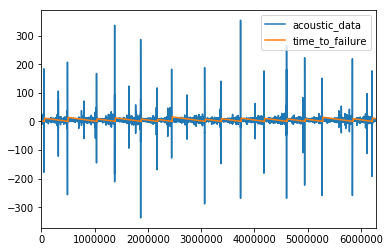

In [5]:
aggdf = pd.read_csv("aggregated_100_mean.csv", index_col =False)
aggdf = aggdf.drop("Unnamed: 0", axis=1)
aggdf.plot()
f"Takes up {aggdf.memory_usage().sum()/1_000_000} MB of memory"


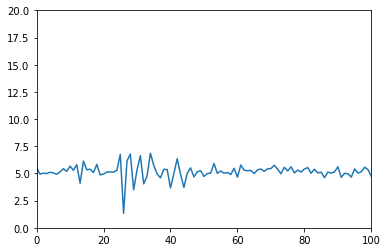

In [14]:
import matplotlib.animation as animation
nparr = aggdf["acoustic_data"].to_numpy()
window = 1000
jump_size=10
interval = 30
speed = jump_size/(interval/1000) # agg data points per 
fig, ax = plt.subplots()
ax.set_xlim(( 0, 100))
ax.set_ylim((0, 20))
line,  = ax.plot([],[])
def animate(i):
    jump = i*jump_size
    x, y = np.arange(0,window), nparr[jump:window+jump]
    line.set_data(x,y) 
anim = animation.FuncAnimation(fig, animate, frames=1500, interval=interval)


In [15]:
IPython.display.HTML(anim.to_jshtml())

Rolling fourier series

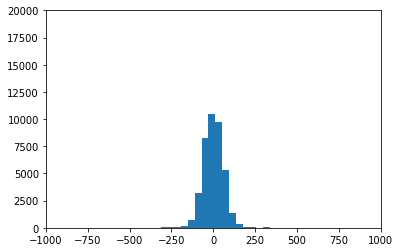

In [3]:
aggdf = pd.read_csv("aggregated_1000_mean.csv", index_col =False)
nparr = aggdf["acoustic_data"].to_numpy()
c = 10_00

fig, ax, = plt.subplots()
def update_hist(i):
    ax.clear()
    seg = nparr[i*c :(i+20)*c]
    seg = seg-np.mean(seg)
    ft = np.fft.hfft(seg)
    fts.append(ft)
    ax.hist(ft, bins=100)
    ax.set_xlim(( -1000, 1000))
    ax.set_ylim(( 0, 20000))

    
anim = animation.FuncAnimation(fig, update_hist,frames=100)

In [ ]:
IPython.display.HTML(anim.to_jshtml())

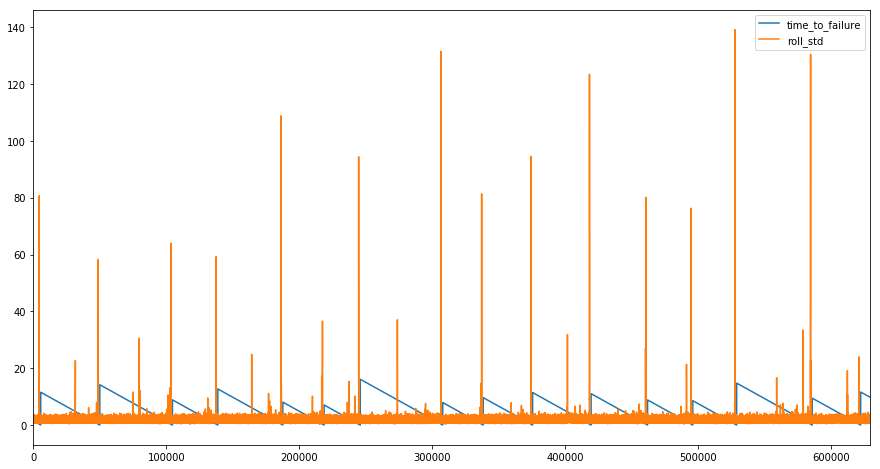

In [14]:
aggdf = pd.read_csv("aggregated_1000_mean.csv", index_col =False)
aggdf["roll_std"] = aggdf["acoustic_data"].rolling(10).std()*10
aggdf[["time_to_failure", "roll_std"]].plot(figsize=(15,8))

[-0.11984354 -0.11994354 -0.11484354 ... -0.24424354 -0.23824354
 -0.23654354]


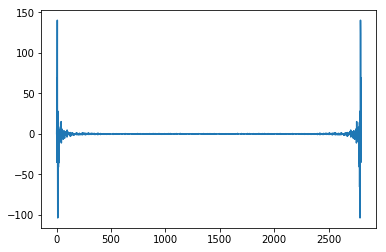

In [59]:
test = pd.read_csv("LANL-Earthquake-Prediction/test/seg_00030f.csv")
test = test.groupby(test.index//100).mean().rolling(100).mean().dropna()
npa = test.to_numpy().reshape(-1)
npanm = npa - np.mean(npa)
print(npanm)
ft = np.fft.hfft(npanm)
plt.plot(ft)

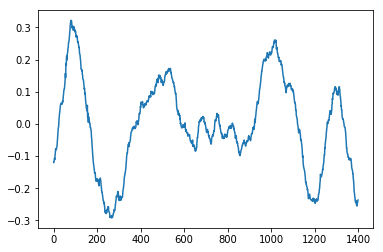

In [62]:
plt.plot(npanm)

150

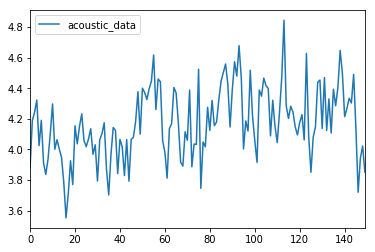

In [3]:
test = pd.read_csv("LANL-Earthquake-Prediction/test/seg_0012b5.csv")
test = test.groupby(test.index//1000).mean()
test.plot()
len(test)

In [ ]:
aggdf = pd.read_csv("aggregated_1000_mean.csv", index_col =False)
nparr = aggdf["acoustic_data"].to_numpy()